# Anisotropic Gaussian Field Model


In [1]:
# Importing necessary libraries
from __future__ import print_function
import numpy as np
import matplotlib.pyplot as plt
import gstools as gs
import seaborn as sns
import matplotlib.lines as mlines # For custom legends
import pandas as pd
from scipy.integrate import quad
from scipy.optimize import brentq
from scipy.stats import norm, chi2
import warnings
warnings.filterwarnings("ignore", category=UserWarning, module="matplotlib")
from skimage.measure import euler_number, label
# Set random seed for reproducibility
# np.random.seed(31415926)

# Apply the default theme for Seaborn
sns.set_theme(context='paper', font='sans-serif', font_scale=1, color_codes=True, rc=None)
sns.set_style()

## Covariance model

This model is given by the following variogram

$$
\gamma(r)=
\sigma^{2}
\left(1-\exp\left(-\left(s\cdot\frac{r}{\ell}\right)^{2}\right)\right)+n
$$

where $\sigma^2=1$ (variance), $n=0$ (nugget),  $s$ is `rescale_gs_tools`, $\ell$ is `len_scale_gs_tools`. 

We choose that `unit_length` pixels are considered as one physical unit, and we set `rescale_gs_tools` = 1/`unit_length`. The domain is a square of `field_size` pixels side and the physical size of the domain is $[0,T]^2$ whith $T=$`T_parameter` and `T_parameter`=`field_size` / `unit_lengt`.


Observe that, in physical units,

$$
\mathrm{Var}(X'_i)=2 \frac{s^2}{s^2\ell^2} = a^{\pm 2}
\text{ and }
\mathrm{Var}(X')=
P_{-\theta_0}\left(\begin{array}{cc}\kappa^2_1& 0 \\0 & \kappa^2_2\end{array}\right) P_{\theta_0},
$$
where $a$ is `a_parameter`, $\kappa_i^2=a^{\pm 2}$ and $\theta_0$ is `angles` in radians. Hence 
$$
\kappa^2=1-\frac{\kappa_1^2}{\kappa_2^2}=1-a^{-4}
\text{ and }
a=\frac1{(1-\kappa^2)^{\frac14}}
$$



In [2]:
# Define model parameters
kappa = 0.9
a_parameter = (1 / (1-kappa**2))**(1/4) # Rescale the parameter
print("kappa = ", kappa)
print("a_parameter = ", a_parameter)

field_size = 1000 # Size of the field in each direction (number of pixels)
unit_length = 10 # Unit length for the field in each direction; `unit_length` consecutive pixels are considered as one physical unit
T_parameter = field_size / unit_length # Parameter for the model: size of the observation window in physical units
print("T_parameter = ", T_parameter)

rescale_gs_tools = 1/unit_length # per coordinate
print("rescale_gs_tools = ", rescale_gs_tools)
len_scale_gs_tools = np.sqrt(2) * np.array([a_parameter, 1/a_parameter]) # Length scale of the model
print("len_scale_gs_tools = ", len_scale_gs_tools)

# Anisotropy ratio for the covariance matrix of gs_tools
anis = a_parameter**(-2) 
angles = 1 # Angle in radians
print("theta = ", angles)

levels = [0] # Contour levels of interest
print("levels = ", levels)

min_length = unit_length # Minimum length for a valid contour
nb_points_level_set = int(1e5) # Number of points for the level set
nb_points_display = int(5e4) # Number of points for display

#condition_satisfied = False # Indicator if a valid contour is found
display_figure = True # Indicator if the figure should be displayed
dpi = 200 # Resolution for figures
figsize = (6, 6) # Size of figures

factor_divide = int(8) # Factor to divide gsfield into factor_divide times factor_divide cells

kappa =  0.9
a_parameter =  1.5146475955500731
T_parameter =  100.0
rescale_gs_tools =  0.1
len_scale_gs_tools =  [2.14203517 0.93369148]
theta =  1
levels =  [0]


/opt/anaconda3/lib/python3.12/site-packages/gstools/field/plot.py:401: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


<Figure size 1200x1200 with 0 Axes>

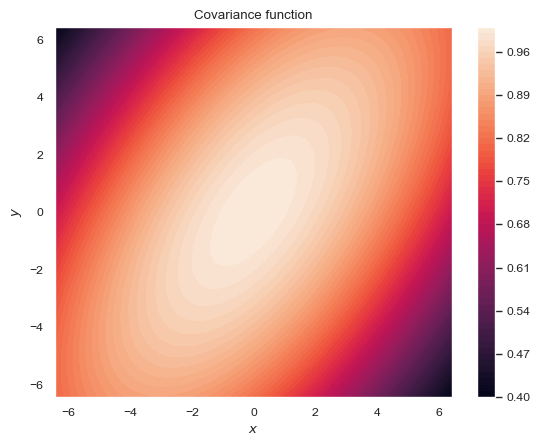

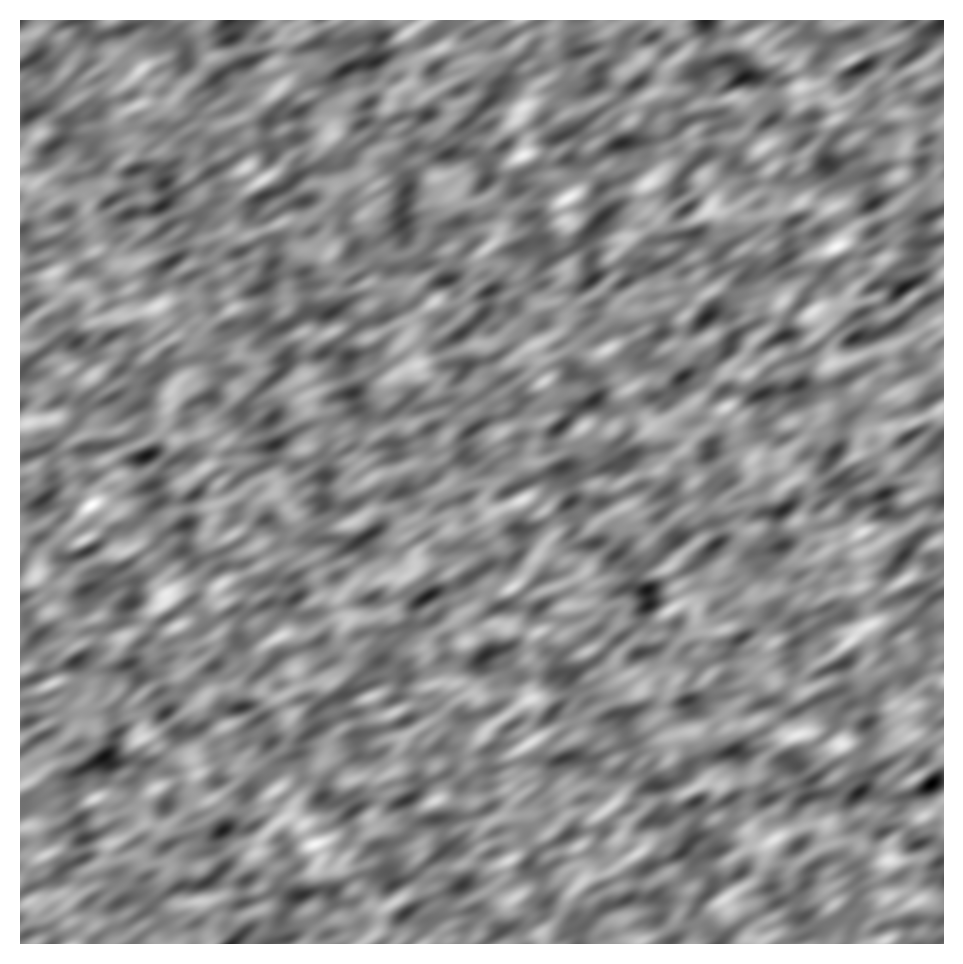

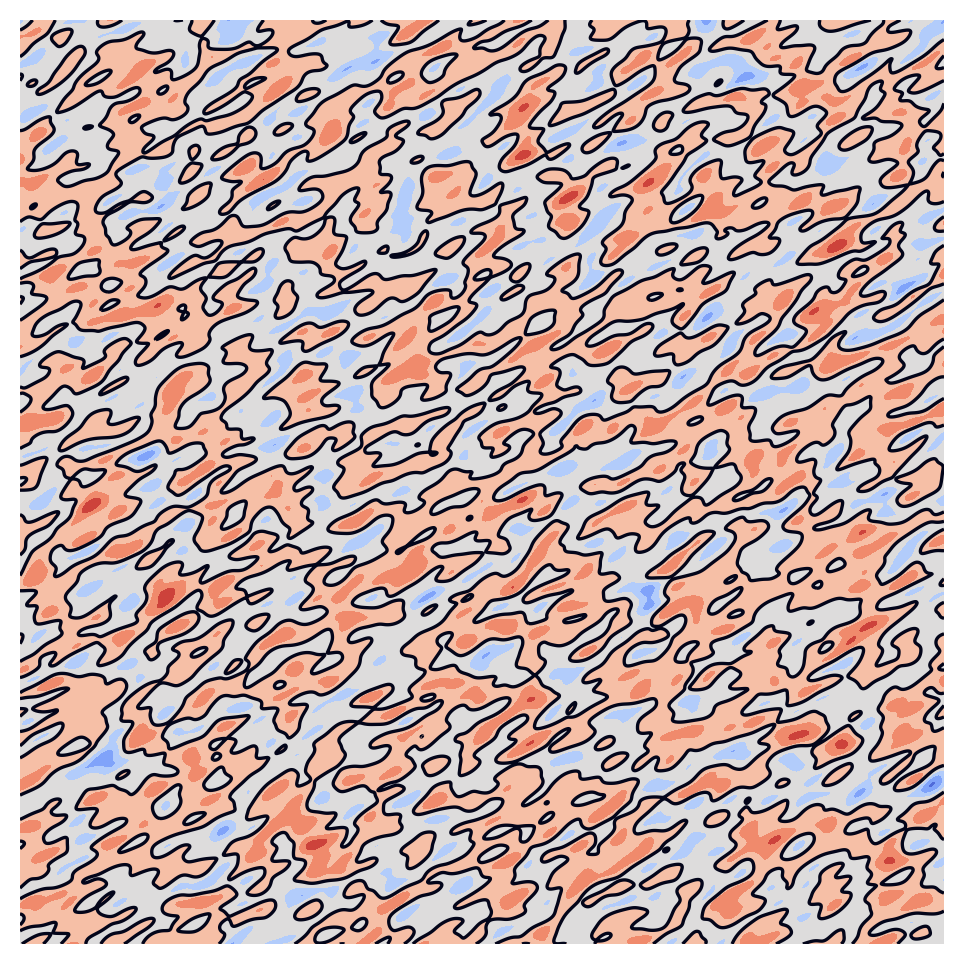

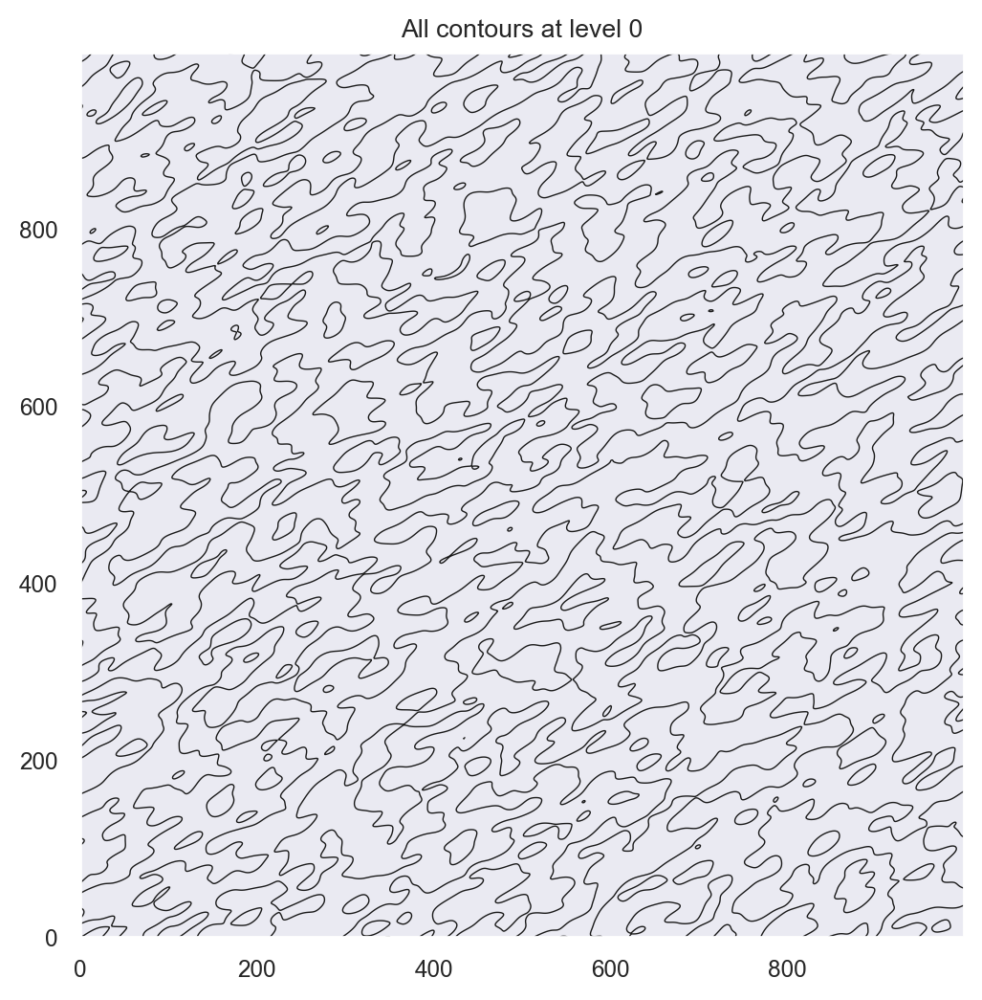

In [3]:
# Generate the Gaussian field
x = y = range(field_size)
model = gs.Gaussian(dim=2, var=1, len_scale=len_scale_gs_tools, angles=angles, rescale=rescale_gs_tools)
srf = gs.SRF(model)
gsfield = srf((x, y), mesh_type='structured')

plt.figure(10, figsize=figsize, dpi=dpi)
model.plot(func='cov_spatial')
plt.title('Covariance function')
plt.grid(False)
plt.show()
# Plot the covariance function

if display_figure:
    # Display the generated Gaussian field
    plt.figure(0, figsize=figsize, dpi=dpi)
    plt.imshow(gsfield, cmap='gray', origin='lower') # origin='lower' to match plt.contour
    #plt.gca().invert_yaxis() # Invert y-axis as in the original script
    plt.axis('scaled')
    plt.grid(False)
    #plt.title('Generated Gaussian Field')
    #plt.colorbar(label='Field Value')
    plt.axis('off')
    plt.savefig("view_on_gf.png", bbox_inches='tight')
    plt.show()

    plt.figure(1, figsize=figsize, dpi=dpi)
    contour = plt.contourf(gsfield, cmap='coolwarm', algorithm='threaded')
    contour0 = plt.contour(gsfield, levels=levels)
    plt.axis('scaled')
    plt.grid(False)
    plt.axis('off')
    plt.savefig("view_on_gf_contour.png", bbox_inches='tight')
    plt.show()
    
# Display all contours at the specified level
plt.figure(3, figsize=figsize, dpi=dpi)
# contourf = plt.contourf(gsfield, levels=levels, cmap='coolwarm', algorithm='threaded') # Optional: fill
contour0_all_lines = plt.contour(gsfield, levels=levels, colors='k', linewidths=0.5) # Lines of all contours
plt.axis('scaled')
plt.grid(False)
plt.title(f'All contours at level {levels[0]}')
plt.show()

Processing all contours at level 0 to distribute a total of 100000 equispaced points proportionally to contour lengths.
Total equispaced points calculated on level 0: 100000 (target: 100000)
Total normals calculated on level 0: 100000
Total equispaced points calculated on level 0: 100000 (target: 100000)
Total normals calculated on level 0: 100000


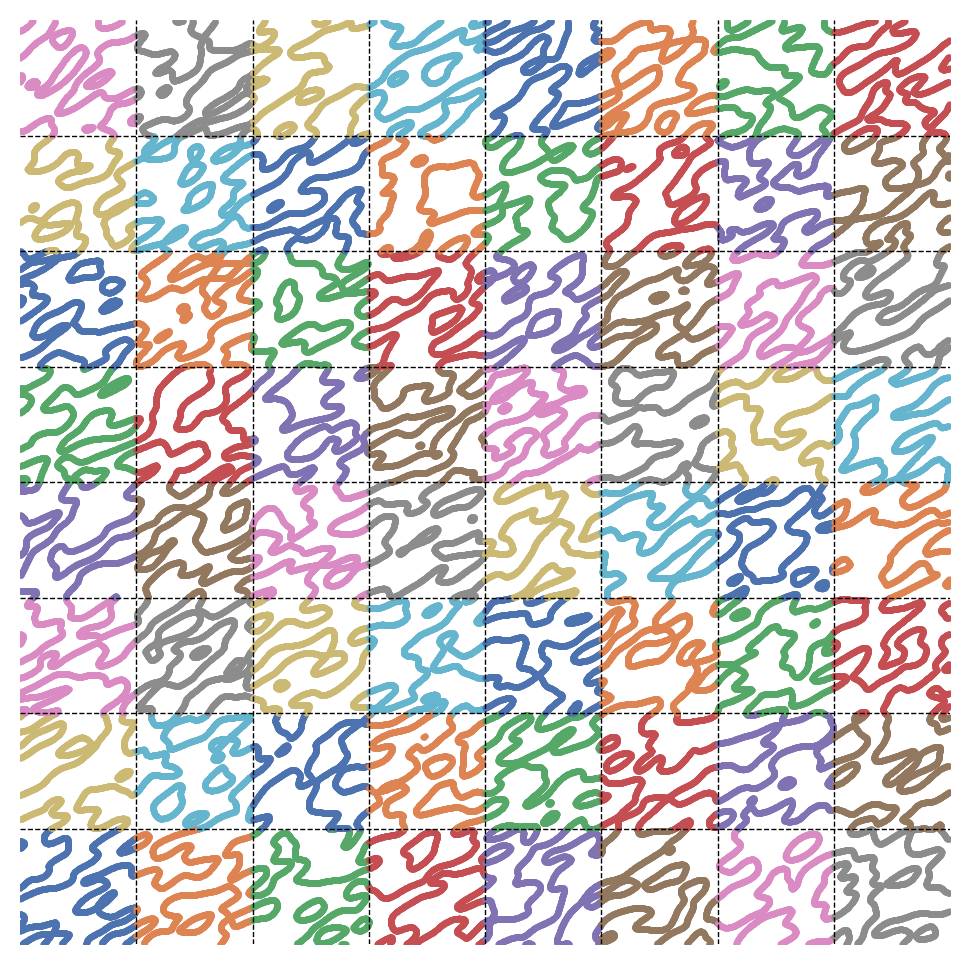

Cell (0, 0): 1641 points
Cell (0, 1): 1643 points
Cell (0, 2): 1583 points
Cell (0, 3): 1538 points
Cell (0, 4): 1684 points
Cell (0, 5): 1507 points
Cell (0, 6): 1351 points
Cell (0, 7): 1583 points
Cell (1, 0): 1452 points
Cell (1, 1): 1589 points
Cell (1, 2): 1329 points
Cell (1, 3): 1673 points
Cell (1, 4): 1751 points
Cell (1, 5): 1518 points
Cell (1, 6): 1441 points
Cell (1, 7): 1539 points
Cell (2, 0): 1697 points
Cell (2, 1): 1862 points
Cell (2, 2): 1575 points
Cell (2, 3): 1502 points
Cell (2, 4): 1491 points
Cell (2, 5): 1655 points
Cell (2, 6): 1607 points
Cell (2, 7): 1535 points
Cell (3, 0): 1322 points
Cell (3, 1): 1739 points
Cell (3, 2): 1539 points
Cell (3, 3): 1563 points
Cell (3, 4): 1428 points
Cell (3, 5): 1497 points
Cell (3, 6): 1632 points
Cell (3, 7): 1295 points
Cell (4, 0): 1682 points
Cell (4, 1): 1459 points
Cell (4, 2): 1406 points
Cell (4, 3): 1719 points
Cell (4, 4): 1665 points
Cell (4, 5): 1443 points
Cell (4, 6): 1205 points
Cell (4, 7): 1553 points


In [4]:
# Calculate and display nb_points_level_set equispaced points and their normals 
# for ALL contours at level 0 (derived from contour0_all_lines).
# This version calculates points and normals, and plots the points.

# Ensure contour0_all_lines, nb_points_level_set, levels, figsize, dpi are defined from previous cells.
all_equispaced_points_level0 = []
all_normals_level0 = []

calculation_done = False
if 'contour0_all_lines' in locals() and contour0_all_lines is not None and \
   hasattr(contour0_all_lines, 'allsegs') and len(contour0_all_lines.allsegs) > 0 and \
   contour0_all_lines.allsegs[0] is not None and 'levels' in locals() and \
   'nb_points_level_set' in locals() and nb_points_level_set > 0:

    print(f"Processing all contours at level {levels[0]} to distribute a total of {nb_points_level_set} equispaced points proportionally to contour lengths.")

    valid_contour_paths_data = []
    total_length_all_valid_paths = 0.0

    # First pass: Calculate lengths and collect valid paths
    for contour_path_coords in contour0_all_lines.allsegs[0]:
        if len(contour_path_coords) < 2: # Need at least 2 points for a path
            continue

        path_segment_lengths_list = [np.sqrt((contour_path_coords[k][0] - contour_path_coords[k-1][0])**2 + \
                                        (contour_path_coords[k][1] - contour_path_coords[k-1][1])**2)
                                for k in range(1, len(contour_path_coords))]
        current_path_total_length = np.sum(path_segment_lengths_list)

        if current_path_total_length < 1e-9: # Skip very short or zero-length paths
            continue
        
        valid_contour_paths_data.append({
            "coords": contour_path_coords,
            "segment_lengths": path_segment_lengths_list, # Store the list of segment lengths
            "total_length": current_path_total_length
        })
        total_length_all_valid_paths += current_path_total_length

    if not valid_contour_paths_data or total_length_all_valid_paths < 1e-9:
        print(f"No valid contour paths found or total length is negligible at level {levels[0]}. Cannot distribute points.")
    else:
        # Distribute nb_points_level_set proportionally using Largest Remainder Method
        num_points_for_each_path_final = np.zeros(len(valid_contour_paths_data), dtype=int)
        
        path_lengths_array = np.array([path_data["total_length"] for path_data in valid_contour_paths_data])
        exact_allocations = (path_lengths_array / total_length_all_valid_paths) * nb_points_level_set
        
        num_points_for_each_path_final = np.floor(exact_allocations).astype(int)
        remainders = exact_allocations - num_points_for_each_path_final
        
        num_remaining_points_to_distribute = nb_points_level_set - np.sum(num_points_for_each_path_final)
        
        if num_remaining_points_to_distribute > 0:
            indices_sorted_by_remainder = np.argsort(remainders)[::-1] # Sort descending
            for k_rem in range(num_remaining_points_to_distribute):
                # Distribute remaining points to paths with largest remainders
                # Cycle through indices if num_remaining_points_to_distribute > len(paths)
                num_points_for_each_path_final[indices_sorted_by_remainder[k_rem % len(indices_sorted_by_remainder)]] += 1

        # Second pass: Generate points and normals for each path based on allocated points
        for i, path_data in enumerate(valid_contour_paths_data):
            num_points_this_path = num_points_for_each_path_final[i]

            if num_points_this_path <= 0: # If a path gets 0 points, skip it
                continue

            contour_path_coords_current = path_data["coords"]
            path_segment_lengths_current = path_data["segment_lengths"] # Use the stored list
            current_path_total_length_val = path_data["total_length"]
            
            equispaced_distances = np.linspace(0, current_path_total_length_val, num_points_this_path, endpoint=False)
            
            cumulative_lengths = np.cumsum(path_segment_lengths_current)
            segment_start_lengths = np.concatenate(([0.0], cumulative_lengths[:-1]))

            for dist in equispaced_distances:
                segment_idx = np.searchsorted(cumulative_lengths, dist, side='right')
                if segment_idx >= len(path_segment_lengths_current): # path_segment_lengths_current is a list
                    segment_idx = len(path_segment_lengths_current) - 1
                
                pt_A = contour_path_coords_current[segment_idx]
                pt_B = contour_path_coords_current[segment_idx + 1]

                dist_into_segment = dist - segment_start_lengths[segment_idx]
                segment_len = path_segment_lengths_current[segment_idx]
                ratio = 0.0 if segment_len < 1e-9 else dist_into_segment / segment_len
                ratio = np.clip(ratio, 0.0, 1.0)

                x_p = pt_A[0] + ratio * (pt_B[0] - pt_A[0])
                y_p = pt_A[1] + ratio * (pt_B[1] - pt_A[1])
                all_equispaced_points_level0.append(np.array([x_p, y_p]))

                dx_tangent = pt_B[0] - pt_A[0]
                dy_tangent = pt_B[1] - pt_A[1]
                nx = -dy_tangent
                ny = dx_tangent
                norm_magnitude = np.sqrt(nx**2 + ny**2)
                if norm_magnitude > 1e-9:
                    nx /= norm_magnitude
                    ny /= norm_magnitude
                else:
                    nx, ny = 0.0, 0.0 
                all_normals_level0.append(np.array([nx, ny]))
        
        if all_equispaced_points_level0:
            print(f"Total equispaced points calculated on level {levels[0]}: {len(all_equispaced_points_level0)} (target: {nb_points_level_set})")
            print(f"Total normals calculated on level {levels[0]}: {len(all_normals_level0)}")
            calculation_done = True
        else:
            print(f"No equispaced points were calculated for level {levels[0]}. This might happen if all paths were allocated 0 points.")

else:
    print("Could not calculate equispaced points and normals for all level 0 contours. " +
          "Missing prerequisites or 'contour0_all_lines' is not structured as expected.")



# Now, distribute these points and normals into cells
#factor_divide = 4
cell_height = field_size // factor_divide
cell_width = field_size // factor_divide

# Create a nested list to store points for each cell
all_cells_equispaced_points = [[[] for _ in range(factor_divide)] for _ in range(factor_divide)]
all_cells_normals = [[[] for _ in range(factor_divide)] for _ in range(factor_divide)]

for point, normal in zip(all_equispaced_points_level0, all_normals_level0):
    col_idx = int(point[0] // cell_width)
    row_idx = int(point[1] // cell_height)
    
    # Clamp indices to be within the grid
    col_idx = min(col_idx, factor_divide - 1)
    row_idx = min(row_idx, factor_divide - 1)
    
    all_cells_equispaced_points[row_idx][col_idx].append(point)
    all_cells_normals[row_idx][col_idx].append(normal)

# Visualization
fig, ax = plt.subplots(figsize=figsize, dpi=dpi)
# ax.imshow(gsfield, cmap='gray', origin='lower')

# Draw grid lines
for i in range(1, factor_divide):
    ax.axhline(y=i * cell_height, color='black', linestyle='--', linewidth=0.5)
    ax.axvline(x=i * cell_width, color='black', linestyle='--', linewidth=0.5)

# Plot points cell by cell
for i in range(factor_divide):
    for j in range(factor_divide):
        if all_cells_equispaced_points[i][j]:
            points_in_cell = np.array(all_cells_equispaced_points[i][j])
            ax.scatter(points_in_cell[:, 0], points_in_cell[:, 1], s=2)

ax.axis([0, field_size, 0, field_size])
#ax.set_title(f'Equispaced Points Distributed in a {factor_divide}x{factor_divide} Grid')
plt.axis('off')
plt.savefig("view_on_gf_cells.png", bbox_inches='tight')
plt.grid(False)
plt.show()

# Print summary
for i in range(factor_divide):
    for j in range(factor_divide):
        num_points = len(all_cells_equispaced_points[i][j])
        print(f"Cell ({i}, {j}): {num_points} points")


In [5]:
# Calculate and display the perimeter of the level set 0
# This cell assumes 'calculation_done' and 'total_length_all_valid_paths' (from cell 12) are available.

if 'calculation_done' in locals() and calculation_done and \
   'total_length_all_valid_paths' in locals():
    
    perimeter_level_set0 = total_length_all_valid_paths
    print(f"Perimeter of the level set {levels[0]}: {perimeter_level_set0:.2f}")
    
    # Displaying it as a variable named 'perimeter' as requested (though the variable is perimeter_level_set0)
    perimeter = perimeter_level_set0 * rescale_gs_tools # Rescale to physical units
    print(f"Variable 'perimeter' (representing perimeter of level set {levels[0]}): {perimeter:.2f}")

else:
    print("Skipping perimeter calculation for level set 0: Prerequisites not met.")
    print("Ensure cell 12 has run successfully and 'calculation_done' is True and 'total_length_all_valid_paths' is available.")
    perimeter_level_set0 = None # Define it as None if not calculated
    perimeter = None
    if 'calculation_done' not in locals() or not calculation_done:
        print("- 'calculation_done' is not True or not defined.")
    if 'total_length_all_valid_paths' not in locals():
        print("- 'total_length_all_valid_paths' is not defined.")

Perimeter of the level set 0: 53600.77
Variable 'perimeter' (representing perimeter of level set 0): 5360.08


/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


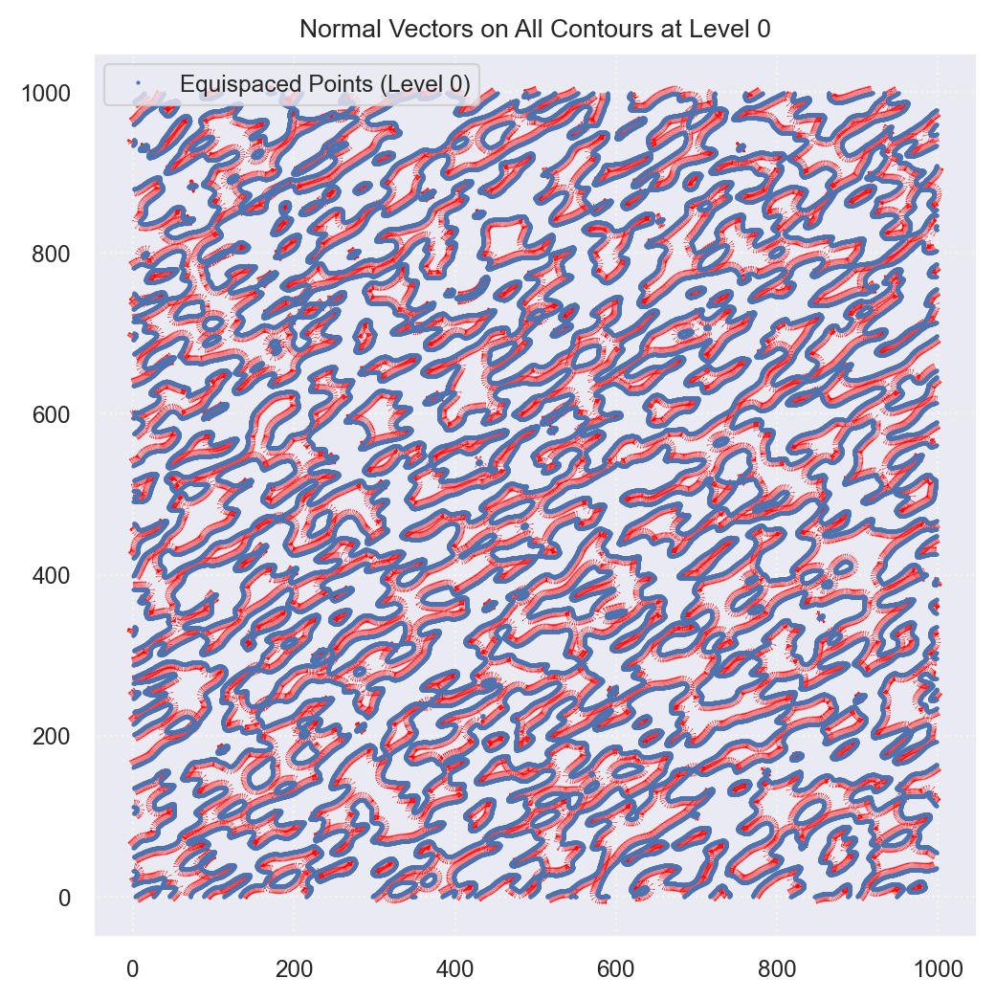

/var/folders/qz/tf99qztd2jx62vrtddtkr1700000gq/T/ipykernel_9897/1427448990.py:59: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('viridis', factor_divide*factor_divide)


In [6]:
# Visualization of normal vectors for all equispaced points on level 0 contours
# This cell assumes 'calculation_done', 'all_equispaced_points_level0', 
# 'all_normals_level0', 'contour0_all_lines', 'figsize', 'dpi', 'levels' are available.

if display_figure and calculation_done and \
   'all_equispaced_points_level0' in locals() and len(all_equispaced_points_level0) > 0 and \
   'all_normals_level0' in locals() and len(all_normals_level0) == len(all_equispaced_points_level0):

    fig_all_normals, ax_all_normals = plt.subplots(figsize=figsize, dpi=dpi)

    # Plot original contours for context
    if 'contour0_all_lines' in locals() and contour0_all_lines is not None and \
       hasattr(contour0_all_lines, 'allsegs') and len(contour0_all_lines.allsegs) > 0 and \
       contour0_all_lines.allsegs[0] is not None:
        for contour_path_coords_plot in contour0_all_lines.allsegs[0]:
            if len(contour_path_coords_plot) > 1:
                xs_orig, ys_orig = zip(*contour_path_coords_plot)
                ax_all_normals.plot(xs_orig, ys_orig, color='gray', linewidth=0.5, alpha=0.7)
    
    points_array = np.array(all_equispaced_points_level0)
    normals_array = np.array(all_normals_level0)

    if points_array.ndim == 2 and points_array.shape[1] == 2 and \
       normals_array.ndim == 2 and normals_array.shape[1] == 2:
        
        # Plot the equispaced points
        ax_all_normals.plot(points_array[:, 0], points_array[:, 1], 'bo', markersize=0.5, label=f'Equispaced Points (Level 0)')
        
        # Plot the normal vectors
        # Subsample normals for clarity if there are too many
        subsample_rate = 1
        if len(points_array) > nb_points_display:
            subsample_rate = len(points_array) // nb_points_display # Aim for around nb_points_display arrows
            
        ax_all_normals.quiver(points_array[::subsample_rate, 0], points_array[::subsample_rate, 1], 
                                normals_array[::subsample_rate, 0], normals_array[::subsample_rate, 1], 
                                color='red', units='xy', scale_units='xy', scale=0.1, width=0.5, headwidth=3, headlength=4, pivot='tail')
        # Note: 'scale', 'width' might need adjustment depending on the density and scale of points.
        # Using 'units='xy', scale_units='xy'' makes the arrow scale with the data units.
        # A smaller 'scale' value makes arrows longer.

    ax_all_normals.axis('scaled')
    title_level_str = str(levels[0]) if 'levels' in locals() and isinstance(levels, list) and len(levels) > 0 else "N/A"
    ax_all_normals.set_title(f'Normal Vectors on All Contours at Level {title_level_str}')
    ax_all_normals.legend()
    plt.grid(True, linestyle=':', alpha=0.5)
    plt.show()
else:
    print("Skipping visualization of normal vectors for all level 0 contours: " +
          "Calculation was not done, or points/normals data is missing or mismatched, or 'display_figure' is False.")

# Visualization of normal vectors for each cell with a different color

if 'all_cells_equispaced_points' in locals() and 'all_cells_normals' in locals():
    fig, ax = plt.subplots(figsize=figsize, dpi=8*dpi)
    # ax.imshow(gsfield, cmap='gray', origin='lower', alpha=0.5)

    # Create a colormap
    colors = plt.cm.get_cmap('viridis', factor_divide*factor_divide)

    # Draw grid lines
    for i in range(1, factor_divide):
        ax.axhline(y=i * cell_height, color='black', linestyle='--', linewidth=0.5)
        ax.axvline(x=i * cell_width, color='black', linestyle='--', linewidth=0.5)

    # Plot normals for each cell
    cycle = plt.rcParams['axes.prop_cycle'].by_key()['color']
    size_cycle = len(cycle)
    for i in range(factor_divide):
        for j in range(factor_divide):
            if all_cells_equispaced_points[i][j]:
                points_in_cell = np.array(all_cells_equispaced_points[i][j])
                normals_in_cell = np.array(all_cells_normals[i][j])
                #color = colors(plt.rcParams['axes.prop_cycle'][i * factor_divide + j]) # Use a distinct color for each cell

                # Subsample for clarity
                subsample_rate = 1
                if len(points_in_cell) > (nb_points_display / (factor_divide**2)):
                    subsample_rate = int(len(points_in_cell) // (nb_points_display / (factor_divide**2)))
                
                ax.quiver(points_in_cell[::subsample_rate, 0], points_in_cell[::subsample_rate, 1], 
                          normals_in_cell[::subsample_rate, 0], normals_in_cell[::subsample_rate, 1], 
                          color=cycle[(i * factor_divide + j) % size_cycle], units='xy', scale_units='xy', scale=0.1, width=0.5, 
                          headwidth=3, headlength=4, pivot='tail')

    ax.axis([0, field_size, 0, field_size])
    #ax.set_title(f'Normal Vectors by Cell')
    plt.axis('off')
    plt.savefig("view_on_gf_cell_normals.png", bbox_inches='tight')
    plt.grid(False)
    plt.show()
else:
    print("Data for cells not available. Please run cell 6 first.")

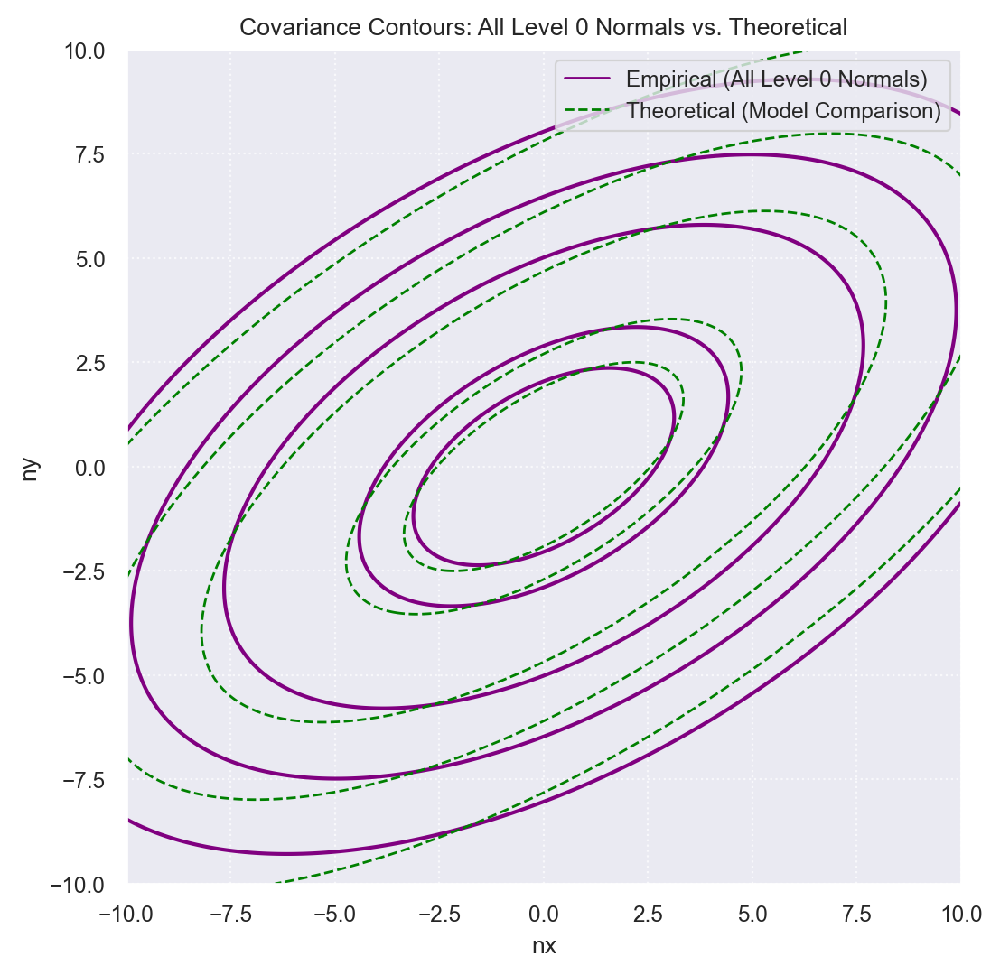

In [7]:
# Calculation and plotting of covariance contours based on ALL normals from level 0 contours
# This cell assumes 'calculation_done', 'all_normals_level0', 'angles', 'anis', 'figsize', 'dpi' are available.

if calculation_done and 'all_normals_level0' in locals() and len(all_normals_level0) > 0:
    plt.figure(figsize=figsize, dpi=dpi)
    
    normals_level0_array = np.array(all_normals_level0)
    if normals_level0_array.ndim != 2 or normals_level0_array.shape[1] != 2:
        print("Skipping covariance for level 0: 'all_normals_level0' is not a 2D array of normals.")
    else:
        u_normals_all = normals_level0_array.T # Shape (2, N)
        
        # Empirical covariance matrix for all normals on level 0
        # Filter out zero-magnitude normals if any, as they don't contribute to direction
        valid_normals_mask = np.linalg.norm(u_normals_all, axis=0) > 1e-9
        if np.sum(valid_normals_mask) < 2: # Need at least 2 valid normals for covariance
             print(f"Skipping covariance for level 0: Not enough valid (non-zero) normals. Found {np.sum(valid_normals_mask)}.")
        else:
            u_normals_all_valid = u_normals_all[:, valid_normals_mask]
            stat_empirical_cov_all = np.dot(u_normals_all_valid, u_normals_all_valid.T) / u_normals_all_valid.shape[1]

            # Grid for plotting covariance contours (can be reused or adjusted)
            grid_limit_cov_all = 10 # Adjusted limit based on typical normal vector component values
            grid_step_cov_all = 0.05
            grid_x_cov_all = np.arange(-grid_limit_cov_all, grid_limit_cov_all + grid_step_cov_all, grid_step_cov_all)
            grid_y_cov_all = np.arange(-grid_limit_cov_all, grid_limit_cov_all + grid_step_cov_all, grid_step_cov_all)
            X_cov_all, Y_cov_all = np.meshgrid(grid_x_cov_all, grid_y_cov_all)

            # Quadratic form for empirical covariance (all normals level 0)
            Z_empirical_form_all = (stat_empirical_cov_all[0, 0] * X_cov_all**2 + 
                                   2 * stat_empirical_cov_all[0, 1] * X_cov_all * Y_cov_all + 
                                   stat_empirical_cov_all[1, 1] * Y_cov_all**2)

            # Quadratic form for theoretical covariance (model-based)
            # Ensure 'angles' and 'anis' are defined from previous cells
            X_rot_theo_all = X_cov_all * np.cos(angles) - Y_cov_all * np.sin(angles)
            Y_rot_theo_all = X_cov_all * np.sin(angles) + Y_cov_all * np.cos(angles)
            # Theoretical covariance of normals is related to the inverse of the field's covariance tensor components
            # For a Gaussian field with covariance C, the normals' covariance is related to C^-1 (scaled).
            Z_theoretical_form_compare = (a_parameter**2) * (X_rot_theo_all**2) + (a_parameter**(-2)) * (Y_rot_theo_all**2) # Adjusted for normals based on typical anisotropy effect inversion and Palm's formula

            # Plot contours
            # Use fixed levels for better comparison if possible, or percentile-based
            contour_levels_empirical_all = np.percentile(Z_empirical_form_all[np.isfinite(Z_empirical_form_all)], [5, 10, 30, 50, 70])
            contour_levels_theoretical_all = np.percentile(Z_theoretical_form_compare[np.isfinite(Z_theoretical_form_compare)], [5, 10, 30, 50, 70])

            if not np.all(np.isfinite(contour_levels_empirical_all)) or not np.all(np.isfinite(contour_levels_theoretical_all)):
                print("Cannot plot covariance contours due to non-finite level values. Check calculations.")
            else:
                plt.contour(X_cov_all, Y_cov_all, Z_empirical_form_all, levels=contour_levels_empirical_all, colors='purple', linestyles='solid', linewidths=1.5)
                plt.contour(X_cov_all, Y_cov_all, Z_theoretical_form_compare, levels=contour_levels_theoretical_all, colors='green', linestyles='dashed', linewidths=1)

                # Legend
                
                emp_line_all = mlines.Line2D([], [], color='purple', linewidth=1, label='Empirical (All Level 0 Normals)')
                theo_line_all = mlines.Line2D([], [], color='green', linestyle='dashed', linewidth=1, label='Theoretical (Model Comparison)')
                plt.legend(handles=[emp_line_all, theo_line_all])

                plt.axis('scaled')
                plt.grid(True, linestyle=':', alpha=0.7)
                plt.title('Covariance Contours: All Level 0 Normals vs. Theoretical')
                plt.xlabel('nx')
                plt.ylabel('ny')
                plt.show()
else:
    print("Covariance contour calculation for all level 0 normals skipped: " +
          "Calculation was not done, or 'all_normals_level0' is missing or empty.")

In [8]:
# Calculate Euler Characteristic from normals on level 0 contours
# This cell assumes 'calculation_done', 'all_normals_level0',
# 'valid_contour_paths_data', 'num_points_for_each_path_final', and 'levels' (from cell 12 or earlier) are available.

if 'calculation_done' in locals() and calculation_done and \
   'all_normals_level0' in locals() and len(all_normals_level0) > 0 and \
   'valid_contour_paths_data' in locals() and \
   'num_points_for_each_path_final' in locals() and \
   'levels' in locals():

    total_sum_of_angle_changes = 0.0
    current_offset = 0
    total_sum_cos_cabana = 0.0
    total_sum_sin_cabana = 0.0
    total_perimeter_cabana = 0.0

    print(f"Calculating statistics for level set {levels[0]}...")

    for i_path in range(len(valid_contour_paths_data)):
        num_normals_on_this_path = num_points_for_each_path_final[i_path]

        if num_normals_on_this_path < 2: # Need at least 2 normals to calculate angle change along a path segment
            current_offset += num_normals_on_this_path
            continue

        path_normals = all_normals_level0[current_offset : current_offset + num_normals_on_this_path]
        path_points = all_equispaced_points_level0[current_offset : current_offset + num_normals_on_this_path]
        
        
        # Calculate angles for each normal vector on this path
        # Angles are in radians, from -pi to pi, using arctan2(ny, nx)
        angles_on_path = [np.arctan2(normal[1], normal[0]) for normal in path_normals]
        distances_on_path = np.sqrt(np.sum(np.diff(path_points, axis=0)**2, axis=1))

        path_angle_change_sum_for_this_contour = 0.0
        path_distance_change_sum_for_this_contour = 0.0
        # Iterate through normals to sum angle differences
        # including the change from the last normal back to the first to close the loop
        for j in range(num_normals_on_this_path):
            angle1 = angles_on_path[j-1] # For j=0, this is angles_on_path[-1] (last normal's angle)
            angle2 = angles_on_path[j]

            distance = distances_on_path[j] if j < num_normals_on_this_path - 1 else 0 
            # Avoid last point distance by setting it to 0
            # Calculate the cosine and sine of the angle for Cabana's formula
            cos_cabana = np.cos(2*angle2)
            sin_cabana = np.sin(2*angle2)
            total_sum_cos_cabana += distance * cos_cabana
            total_sum_sin_cabana += distance * sin_cabana
 
            delta_angle = angle2 - angle1
            if j==0:
                delta_angle = 0           
            # Correct delta_angle to be in (-pi, pi]
            # This ensures we take the shortest angle between the two vectors
            if delta_angle > np.pi:
                delta_angle -= 2 * np.pi
            elif delta_angle <= -np.pi: # Use <= to handle the case of exactly -pi vs +pi if it occurs
                delta_angle += 2 * np.pi
            # Accumulate the angle change and distance
            path_angle_change_sum_for_this_contour += delta_angle
            path_distance_change_sum_for_this_contour += distance
            
        total_sum_of_angle_changes += path_angle_change_sum_for_this_contour
        total_perimeter_cabana += path_distance_change_sum_for_this_contour
        current_offset += num_normals_on_this_path

    if current_offset != len(all_normals_level0):
        print(f"Warning: Mismatch in total normals processed ({current_offset}) and available normals ({len(all_normals_level0)}).")


    euler_characteristic = total_sum_of_angle_changes / (2 * np.pi)
    bool_image = (gsfield > levels[0])
    euler_characteristic_scikit = euler_number(bool_image, connectivity=1)
    euler_characteristic_scikit2 = euler_number(bool_image, connectivity=2)
    print(f"Euler Characteristic (manual calculation): {euler_characteristic:.4f}")
    print(f"Euler Characteristic (scikit-image): {euler_characteristic_scikit:.4f}")
    print(f"Euler Characteristic (scikit-image, connectivity=2): {euler_characteristic_scikit2:.4f}")
    cos_cabana_integral = total_sum_cos_cabana * rescale_gs_tools
    # Rescale to physical units
    sin_cabana_integral = total_sum_sin_cabana * rescale_gs_tools
    # Rescale to physical units
    total_perimeter_cabana *= rescale_gs_tools # Rescale to physical units
    
    print(f"Integral Cosine of Cabana's formula: {cos_cabana_integral:.4f}")
    print(f"Integral Sine of Cabana's formula: {sin_cabana_integral:.4f}")
    print(f"Total number of normals processed: {len(all_normals_level0)}")

    estimated_angle_cabana = -(1/2)*np.arctan(sin_cabana_integral/cos_cabana_integral)+np.pi/2
    # The angle is estimated from Cabana's formula
    # This is a rough estimate of the average angle of normals
    # The formula is derived from the mean of the normals' angles
    print(f"Estimated angle from Cabana's formula: {estimated_angle_cabana:.4f} radians")
    print(f'Cabana length of level set {levels[0]}: {total_perimeter_cabana:.4f}')
    print(f"Variable 'perimeter' (representing perimeter of level set {levels[0]}): {perimeter:.2f}")

else:
    print("Skipping Euler Characteristic calculation: Prerequisites not met. ")
    print("Ensure cell 12 (the one calculating 'all_normals_level0', etc.) has run successfully, ")
    print("'calculation_done' is True, and all required variables are available in the global scope.")
    # Listing potentially missing variables for debugging:
    for var_name in ['calculation_done', 'all_normals_level0', 'valid_contour_paths_data', 'num_points_for_each_path_final', 'levels']:
        if var_name not in locals():
            print(f"Missing variable: {var_name}")

# Calculate Euler Characteristic and Cabana stats for each cell

# Check for necessary variables from previous cells
if 'all_equispaced_points_level0' in locals() and 'valid_contour_paths_data' in locals() and 'num_points_for_each_path_final' in locals():

    # Initialize storage for the stats for each cell
    cell_perimeters = np.zeros((factor_divide, factor_divide))
    cell_sum_cos_cabana = np.zeros((factor_divide, factor_divide))
    cell_sum_sin_cabana = np.zeros((factor_divide, factor_divide))
    cell_total_angle_changes = np.zeros((factor_divide, factor_divide))

    # Re-iterate through the ordered paths to calculate distances and angle changes correctly.
    current_offset = 0
    for i_path, path_data in enumerate(valid_contour_paths_data):
        num_points_on_this_path = num_points_for_each_path_final[i_path]

        if num_points_on_this_path < 2:
            current_offset += num_points_on_this_path
            continue

        # Get the points and normals for the current path from the global lists
        path_points = np.array(all_equispaced_points_level0[current_offset : current_offset + num_points_on_this_path])
        path_normals = np.array(all_normals_level0[current_offset : current_offset + num_points_on_this_path])

        # Calculate angles for each normal vector on this path
        angles_on_path = np.arctan2(path_normals[:, 1], path_normals[:, 0])

        # Iterate through the points on this path to calculate stats
        for j in range(num_points_on_this_path):
            point_current = path_points[j]
            point_prev = path_points[j-1] # Handles wrap-around for the first point
            
            angle_current = angles_on_path[j]
            angle_prev = angles_on_path[j-1]

            # Determine which cell the current point belongs to
            col_idx = min(int(point_current[0] // cell_width), factor_divide - 1)
            row_idx = min(int(point_current[1] // cell_height), factor_divide - 1)

            # Calculate distance from the previous point
            distance = np.sqrt(np.sum((point_current - point_prev)**2))
            
            # Accumulate perimeter
            cell_perimeters[row_idx, col_idx] += distance

            # Accumulate Cabana stats
            cell_sum_cos_cabana[row_idx, col_idx] += distance * np.cos(2 * angle_current)
            cell_sum_sin_cabana[row_idx, col_idx] += distance * np.sin(2 * angle_current)
            
            # Accumulate angle change
            angle_diff = angle_current - angle_prev
            # Correct for wrapping around -pi/pi
            if angle_diff > np.pi:
                angle_diff -= 2 * np.pi
            if angle_diff < -np.pi:
                angle_diff += 2 * np.pi
            cell_total_angle_changes[row_idx, col_idx] += angle_diff

        current_offset += num_points_on_this_path

    # Rescale to physical units
    cell_perimeters *= rescale_gs_tools
    cell_sum_cos_cabana *= rescale_gs_tools
    cell_sum_sin_cabana *= rescale_gs_tools
    
    # The Euler characteristic is the total angle change divided by 2*pi
    cell_euler_chars = cell_total_angle_changes / (2 * np.pi)

    print("--- Statistics per Cell ---")
    for i in range(factor_divide):
        for j in range(factor_divide):
            print(f"Cell ({i}, {j}):")
            print(f"  Perimeter: {cell_perimeters[i, j]:.2f}")
            print(f"  Sum Cos Cabana: {cell_sum_cos_cabana[i, j]:.2f}")
            print(f"  Sum Sin Cabana: {cell_sum_sin_cabana[i, j]:.2f}")
            print(f"  Euler Characteristic (approx): {cell_euler_chars[i, j]:.2f}")

    # --- Create a Pandas DataFrame for structured results ---
    import pandas as pd

    results_cells = []
    for i in range(factor_divide):
        for j in range(factor_divide):
            results_cells.append({
                'cell': f'({i},{j})',
                'perimeter': cell_perimeters[i, j],
                'sum_cos_cabana': cell_sum_cos_cabana[i, j],
                'sum_sin_cabana': cell_sum_sin_cabana[i, j],
                'euler_characteristic': cell_euler_chars[i, j]
            })

    results_cells_df = pd.DataFrame(results_cells)

    # Display the DataFrame
    print("Per-cell statistics:")
    print(results_cells_df)

else:
    print("Data for cells not available. Please run cell 6 first.")

Calculating statistics for level set 0...
Euler Characteristic (manual calculation): 11.0897
Euler Characteristic (scikit-image): 52.0000
Euler Characteristic (scikit-image, connectivity=2): 50.0000
Integral Cosine of Cabana's formula: -1451.1814
Integral Sine of Cabana's formula: -2591.6785
Total number of normals processed: 100000
Estimated angle from Cabana's formula: 1.0406 radians
Cabana length of level set 0: 5343.0228
Variable 'perimeter' (representing perimeter of level set 0): 5360.08
Euler Characteristic (manual calculation): 11.0897
Euler Characteristic (scikit-image): 52.0000
Euler Characteristic (scikit-image, connectivity=2): 50.0000
Integral Cosine of Cabana's formula: -1451.1814
Integral Sine of Cabana's formula: -2591.6785
Total number of normals processed: 100000
Estimated angle from Cabana's formula: 1.0406 radians
Cabana length of level set 0: 5343.0228
Variable 'perimeter' (representing perimeter of level set 0): 5360.08
--- Statistics per Cell ---
Cell (0, 0):
  P

In [9]:
# Calculate the volume (area) of the sublevel set 0 and its proportion
# This cell assumes 'gsfield', 'levels', and 'field_size' are available from previous cells.

if 'gsfield' in locals() and 'levels' in locals() and len(levels) > 0 and 'field_size' in locals():
    target_level = levels[0]
    
    # Calculate the area of the sublevel set (pixels <= target_level)
    # In a 2D grid, the "volume" is the count of pixels satisfying the condition.
    sublevel_set_area = np.sum(gsfield <= target_level) * rescale_gs_tools**2 # Rescale to physical units
    
    # Calculate the total area of the field
    total_field_area = T_parameter * T_parameter # Or gsfield.size
    
    # Calculate the proportion
    if total_field_area > 0:
        proportion_sublevel_set = sublevel_set_area / total_field_area
    else:
        proportion_sublevel_set = 0 # Avoid division by zero if field_size is 0
        
    print(f"Target level for sublevel set: {target_level}")
    print(f"Area (in physical units) of the sublevel set (Z <= {target_level}): {sublevel_set_area}")
    print(f"Total area of the field (in physical units): {total_field_area}")
    print(f"Proportion of the sublevel set area to total area: {proportion_sublevel_set:.4f}")

    # Assign to variables as requested (optional, but good for potential later use)
    volume_sublevel_set_0 = sublevel_set_area
    proportion_volume_sublevel_set_0 = proportion_sublevel_set

else:
    print("Skipping calculation of sublevel set volume and proportion: Prerequisites not met.")
    missing_vars = []
    if 'gsfield' not in locals():
        missing_vars.append("'gsfield'")
    if 'levels' not in locals() or not levels:
        missing_vars.append("'levels' (or it's empty)")
    if 'field_size' not in locals():
        missing_vars.append("'field_size'")
    if missing_vars:
        print(f"Missing variables: {', '.join(missing_vars)}")

Target level for sublevel set: 0
Area (in physical units) of the sublevel set (Z <= 0): 5038.950000000001
Total area of the field (in physical units): 10000.0
Proportion of the sublevel set area to total area: 0.5039


In [10]:
# Consolidate every scalar diagnostic into a single-row DataFrame for later export.
results_df = pd.DataFrame(columns=[
    'kappa', 'a_parameter', 'theta_rad', 'T_parameter', 'level_val', 'field_size', 'unit_length', 
    'total_points_generated', 'sigma_emp_xx', 'sigma_emp_xy', 'sigma_emp_yy', 
    'empirical_cosine_cabana', 'empirical_sine_cabana', 'euler_characteristic', 
    'perimeter', 'volume_sublevel_set', 'perimeter_cabana', 'estimated_angle_cabana', ''
])

# Ensure every upstream variable is defined before assembling the summary row.
required_vars_for_results = [
    'kappa', 'a_parameter', 'angles', 'T_parameter', 'levels', 'field_size', 'unit_length',
    'all_equispaced_points_level0', 'stat_empirical_cov_all', 'cos_cabana_integral', 
    'sin_cabana_integral', 'euler_characteristic', 'perimeter_level_set0', 
    'sublevel_set_area', 'total_perimeter_cabana', 'estimated_angle_cabana', 'calculation_done'
]

all_vars_defined = True
missing_vars_list = []
for var_name in required_vars_for_results:
    if var_name not in locals():
        all_vars_defined = False
        missing_vars_list.append(var_name)

if not ('calculation_done' in locals() and calculation_done):
    all_vars_defined = False
    if 'calculation_done' not in missing_vars_list:
         missing_vars_list.append("'calculation_done' is False or missing")

if all_vars_defined:
    # One row per notebook run containing every scalar statistic.
    new_row_dict = {
        'kappa': kappa,
        'a_parameter': a_parameter,
        'theta_rad': angles,  # 'angles' encodes the rotation θ
        'T_parameter': T_parameter,
        'level_val': levels[0] if levels and len(levels) > 0 else np.nan,
        'field_size': field_size,
        'unit_length': unit_length,
        'total_points_generated': len(all_equispaced_points_level0) if 'all_equispaced_points_level0' in locals() else 0,
        'sigma_emp_xx': stat_empirical_cov_all[0, 0] if 'stat_empirical_cov_all' in locals() and stat_empirical_cov_all.shape == (2,2) else np.nan,
        'sigma_emp_xy': stat_empirical_cov_all[0, 1] if 'stat_empirical_cov_all' in locals() and stat_empirical_cov_all.shape == (2,2) else np.nan,
        'sigma_emp_yy': stat_empirical_cov_all[1, 1] if 'stat_empirical_cov_all' in locals() and stat_empirical_cov_all.shape == (2,2) else np.nan,
        'empirical_cosine_cabana': cos_cabana_integral if 'cos_cabana_integral' in locals() else np.nan,
        'empirical_sine_cabana': sin_cabana_integral if 'sin_cabana_integral' in locals() else np.nan,
        'euler_characteristic': euler_characteristic if 'euler_characteristic' in locals() else np.nan,
        'perimeter': perimeter if 'perimeter' in locals() else np.nan,  # Pixel perimeter scaled to units
        'volume_sublevel_set': sublevel_set_area if 'sublevel_set_area' in locals() else np.nan,
        'perimeter_cabana': total_perimeter_cabana if 'total_perimeter_cabana' in locals() else np.nan,
        'estimated_angle_cabana': estimated_angle_cabana if 'estimated_angle_cabana' in locals() else np.nan
    }
    new_row_df = pd.DataFrame([new_row_dict])
    results_df = pd.concat([results_df, new_row_df], ignore_index=True)
    #results_df = pd.concat([results_df, results_cells_df], ignore_index=True)  # Uncomment to append cell-wise stats too
    print("Results DataFrame updated:")
    print(results_df.head())
else:
    print("Skipping update of results_df as some prerequisite variables are missing:")
    for mv in missing_vars_list:
        print(f"- {mv}")

# print(results_df)

Results DataFrame updated:
   kappa  a_parameter theta_rad  T_parameter level_val field_size unit_length  \
0    0.9     1.514648         1        100.0         0       1000          10   

  total_points_generated  sigma_emp_xx  sigma_emp_xy  sigma_emp_yy  \
0                 100000      0.364199     -0.241542      0.635801   

   empirical_cosine_cabana  empirical_sine_cabana  euler_characteristic  \
0             -1451.181373           -2591.678472             11.089658   

    perimeter  volume_sublevel_set  perimeter_cabana  estimated_angle_cabana  \
0  5360.07717              5038.95       5343.022787                1.040619   

        
0  NaN  


/var/folders/qz/tf99qztd2jx62vrtddtkr1700000gq/T/ipykernel_9897/4288629446.py:52: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  results_df = pd.concat([results_df, new_row_df], ignore_index=True)


Chi2 p-value: 0.0000
Cabana statistics: 0.5559
Chi2 statistics: 511.2011


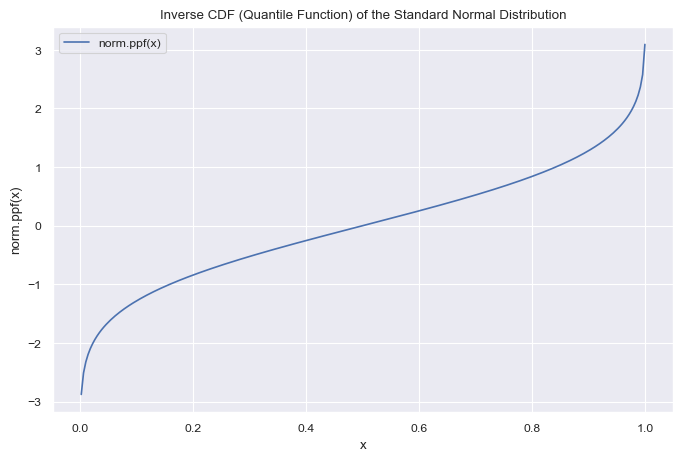

Rescaled level estimate: 0.0098
Rescaled perimeter estimate: 1.6840
Rescaled Euler characteristic: 1.7890
Rescaled Euler characteristic (scikit-image): 8.3886
Rescaled Euler characteristic (scikit-image, connectivity=2): 8.0660
Bierme-Desolneux statistics: 0.63084275
Bierme-Desolneux statistics (scikit-image): 2.95805552
Bierme-Desolneux statistics (scikit-image, connectivity=2): 2.84428415
Cabana statistics: 0.5559


In [11]:
# Compute Cabana and χ² statistics plus the Biermé–Desolneux rescaled quantities.
# Assumes 'results_cells_df' plus the global Cabana integrals have already been produced.
cabana_statistics = np.sqrt((cos_cabana_integral**2 + sin_cabana_integral**2) / total_perimeter_cabana**2)
cells_cosine = results_cells_df['sum_cos_cabana'].values
cells_sine = results_cells_df['sum_sin_cabana'].values
empirical_variance_test_cells = (np.var(cells_cosine) + np.var(cells_sine))/2
chi2_statistics = (cos_cabana_integral**2 + sin_cabana_integral**2) / (factor_divide**2 * empirical_variance_test_cells)
chi2_pvalue = 1 - chi2.cdf(chi2_statistics, df=2)
print(f"Chi2 p-value: {chi2_pvalue:.4f}")
print(f"Cabana statistics: {cabana_statistics:.4f}")
print(f"Chi2 statistics: {chi2_statistics:.4f}")



# Plot the inverse error function (erfinv) for reference
x_vals = np.linspace(-0.999, 0.999, 500)
y_vals = norm.ppf(x_vals)

plt.figure(figsize=(8, 5))
plt.plot(x_vals, y_vals, label='norm.ppf(x)')
plt.title('Inverse CDF (Quantile Function) of the Standard Normal Distribution')
plt.xlabel('x')
plt.ylabel('norm.ppf(x)')
plt.grid(True)
plt.legend()
plt.show()
# Bierme-Desolneux statistics
# Use the inverse CDF (quantile function) of the standard normal distribution
rescaled_level_estimate = norm.ppf(sublevel_set_area / (T_parameter**2))
print(f"Rescaled level estimate: {rescaled_level_estimate:.4f}")
rescaled_perimeter_estimate = (np.sqrt(2 * np.pi)  * perimeter) / (2 * T_parameter**2 * norm.pdf(rescaled_level_estimate))
print(f"Rescaled perimeter estimate: {rescaled_perimeter_estimate:.4f}")
rescaled_euler_characteristic = (2 * np.pi * euler_characteristic) / (rescaled_level_estimate * norm.pdf(rescaled_level_estimate) * T_parameter**2)
print(f"Rescaled Euler characteristic: {rescaled_euler_characteristic:.4f}")
rescaled_euler_characteristic_scikit = (2 * np.pi * euler_characteristic_scikit) / (rescaled_level_estimate * norm.pdf(rescaled_level_estimate) * T_parameter**2)
print(f"Rescaled Euler characteristic (scikit-image): {rescaled_euler_characteristic_scikit:.4f}")
rescaled_euler_characteristic_scikit2 = (2 * np.pi * euler_characteristic_scikit2) / (rescaled_level_estimate * norm.pdf(rescaled_level_estimate) * T_parameter**2)
print(f"Rescaled Euler characteristic (scikit-image, connectivity=2): {rescaled_euler_characteristic_scikit2:.4f}")

bierme_desolneux_statistics = np.abs(rescaled_euler_characteristic / (rescaled_perimeter_estimate**2))
bierme_desolneux_statistics_scikit = np.abs(rescaled_euler_characteristic_scikit / (rescaled_perimeter_estimate**2))
bierme_desolneux_statistics_scikit2 = np.abs(rescaled_euler_characteristic_scikit2 / (rescaled_perimeter_estimate**2))
print(f"Bierme-Desolneux statistics: {bierme_desolneux_statistics:.8f}")
print(f"Bierme-Desolneux statistics (scikit-image): {bierme_desolneux_statistics_scikit:.8f}")
print(f"Bierme-Desolneux statistics (scikit-image, connectivity=2): {bierme_desolneux_statistics_scikit2:.8f}")
print(f"Cabana statistics: {cabana_statistics:.4f}")

In [12]:
# Helper integrals defining the theoretical Cabana and Biermé–Desolneux response curves.
def elliptic_cabana(kappa_var):
    """Return g(κ)=∫(2cos²θ−1)(1−κ²cos²θ)^(-3/2)dθ / ∫(1−κ²cos²θ)^(-3/2)dθ for κ∈(0,1)."""

    def numerator_integrand(theta):
        cos_theta_sq = np.cos(theta)**2
        return (2 * cos_theta_sq - 1) * (1 - (kappa_var**2) * cos_theta_sq)**(-3/2)

    def denominator_integrand(theta):
        cos_theta_sq = np.cos(theta)**2
        return (1 - (kappa_var**2) * cos_theta_sq)**(-3/2)

    lower_limit = 0
    upper_limit = np.pi / 2

    try:
        with warnings.catch_warnings(record=True) as w:
            warnings.simplefilter("always", UserWarning)
            integral_numerator, err_num = quad(numerator_integrand, lower_limit, upper_limit, epsrel=1e-12, epsabs=1e-12)
            if w and issubclass(w[-1].category, UserWarning):
                err_num_msg = str(w[-1].message)
    except Exception as e:
        err_num_msg = str(e)
        integral_numerator = np.nan 

    try:
        with warnings.catch_warnings(record=True) as w:
            warnings.simplefilter("always", UserWarning)
            integral_denominator, err_den = quad(denominator_integrand, lower_limit, upper_limit, epsrel=1e-12, epsabs=1e-12)
            if w and issubclass(w[-1].category, UserWarning):
                err_den_msg = str(w[-1].message)
    except Exception as e:
        err_den_msg = str(e)
        integral_denominator = np.nan

    if np.isinf(integral_numerator) or np.isinf(integral_denominator) or \
       np.isnan(integral_numerator) or np.isnan(integral_denominator) or \
       abs(integral_denominator) < 1e-12:
        return np.nan
        
    return integral_numerator / integral_denominator

def elliptic_bierme_desolneux(kappa_var):
    """Return R(κ)=sqrt(1-κ²)/[∫sqrt(1-κ² sin²θ)dθ]^2 for κ∈(0,1)."""

    def denominator_integrand(theta):
        sin_theta_sq = np.sin(theta)**2
        return np.sqrt(1 - (kappa_var**2) * sin_theta_sq)

    lower_limit = 0
    upper_limit = np.pi / 2

    try:
        with warnings.catch_warnings(record=True) as w:
            warnings.simplefilter("always", UserWarning)
            integral_denominator_part, err_den = quad(denominator_integrand, lower_limit, upper_limit, epsrel=1e-12, epsabs=1e-12)
            if w and issubclass(w[-1].category, UserWarning):
                err_den_msg = str(w[-1].message)
    except Exception as e:
        err_den_msg = str(e)
        integral_denominator_part = np.nan

    if np.isnan(integral_denominator_part) or abs(integral_denominator_part) < 1e-12: 
        return np.nan
        
    return np.sqrt(1 - (kappa_var**2)) / (integral_denominator_part**2)

# Quick sanity check of the helper functions evaluated at the notebook's κ.
kappa_test = kappa
resultat = elliptic_cabana(kappa_test)
print(f"For kappa = {kappa_test}, we have: {resultat:.4f}")
print(f"elliptic_cabana({kappa_test}) = {resultat}")

kappa_test = kappa
resultat = elliptic_bierme_desolneux(kappa_test)
print(f"For kappa = {kappa_test}, we have: {resultat:.4f}")
print(f"elliptic_bierme_desolneux({kappa_test}) = {resultat}")



For kappa = 0.9, we have: 0.5560
elliptic_cabana(0.9) = 0.5560266949704481
For kappa = 0.9, we have: 0.3175
elliptic_bierme_desolneux(0.9) = 0.3175017515036052


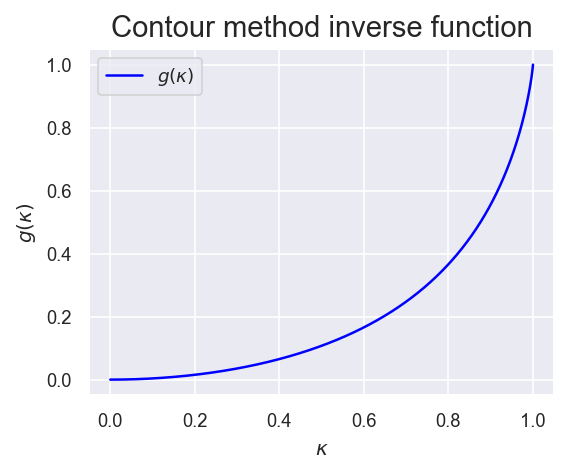

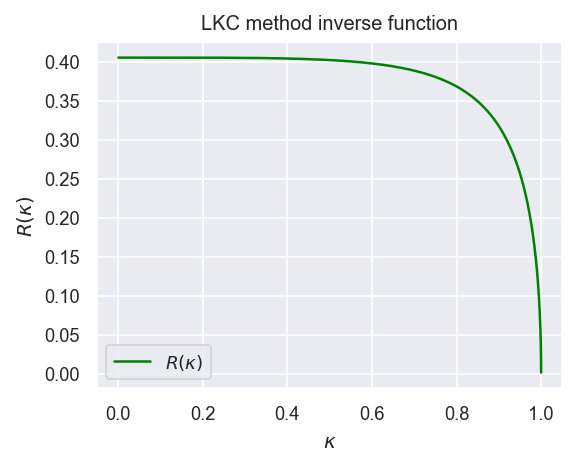

In [13]:
# Trace both theoretical inverse functions over κ∈[0,1) for visual reference.
kappa_values = np.linspace(0, 1-1e-6, 5000)

# Cabana response curve g(κ).
elliptic_cabana_values = [elliptic_cabana(kappa) for kappa in kappa_values]

plt.figure(figsize=(4, 3), dpi=150)
plt.plot(kappa_values, elliptic_cabana_values, label='$g(\\kappa)$', color='blue')
plt.title('Contour method inverse function', fontsize=14)
plt.xlabel('$\\kappa$')
plt.ylabel('$g(\\kappa)$')
plt.grid(True)
plt.legend()
plt.show()

# Biermé–Desolneux response curve R(κ).
elliptic_bierme_desolneux_values = [elliptic_bierme_desolneux(kappa) for kappa in kappa_values]

plt.figure(figsize=(4, 3), dpi=150)
plt.plot(kappa_values, elliptic_bierme_desolneux_values, label='$R(\\kappa)$', color='green')
plt.title('LKC method inverse function')
plt.xlabel('$\\kappa$')
plt.ylabel('$R(\\kappa)$')
plt.grid(True)
plt.legend()
plt.show()

In [14]:
# Numerical inversion helpers turning Cabana/LKC statistics back into κ estimates.
# The functions rely on scipy.brentq and expect the target statistic to live in the image of the
# corresponding theoretical function.
def cabana_kappa_estimate(x_target):
    """Find κ such that g(κ)=x_target, returning NaN if the root-finding preconditions fail."""
    if np.isnan(x_target):
        print("Warning: x_target is NaN. Cannot find kappa_estimate.")
        return np.nan
    def objective_function(kappa_var_obj):
        if not (0 < kappa_var_obj < 1):
            return np.inf 
        val = elliptic_cabana(kappa_var_obj)
        if np.isnan(val):
            return np.inf
        return val - x_target
    kappa_min = 1e-9
    kappa_max = 1.0 - 1e-9
    try:
        f_min = objective_function(kappa_min)
        f_max = objective_function(kappa_max)
        if np.isinf(f_min) or np.isinf(f_max) or np.isnan(f_min) or np.isnan(f_max):
            if np.isnan(elliptic_cabana(0.5)):
                 print("Reminder: elliptic_cabana seems to consistently return NaN.")
            return np.nan
        if f_min * f_max >= 0:
            if abs(f_min) < 1e-12:
                return kappa_min
            if abs(f_max) < 1e-12:
                return kappa_max
            return np.nan
        kappa_estimate_val = brentq(objective_function, kappa_min, kappa_max)
        return kappa_estimate_val
    except ValueError as e:
        return np.nan
    except Exception as e:
        return np.nan
    
def bierme_desolneux_kappa_estimate(x_target):
    """Find κ such that R(κ)=x_target, returning NaN when the solver cannot bracket a root."""
    if np.isnan(x_target):
        print("Warning: x_target is NaN. Cannot find kappa_estimate.")
        return np.nan
    def objective_function(kappa_var_obj):
        if not (0 < kappa_var_obj < 1):
            return np.inf 
        val = elliptic_bierme_desolneux(kappa_var_obj) 
        if np.isnan(val):
            return np.inf 
        return val - x_target
    kappa_min = 1e-15
    kappa_max = 1.0 - 1e-15
    try:
        f_min = objective_function(kappa_min)
        f_max = objective_function(kappa_max)
        if np.isinf(f_min) or np.isinf(f_max) or np.isnan(f_min) or np.isnan(f_max):
            if np.isnan(elliptic_bierme_desolneux(0.5)):
                 print("Reminder: elliptic_bierme_desolneux seems to consistently return NaN.")
            return np.nan
        if f_min * f_max >= 0:
            if abs(f_min) < 1e-12:
                return kappa_min
            if abs(f_max) < 1e-12:
                return kappa_max
            #if x_target == 1 and abs(f_min) < 1e-9: 
            #    return kappa_min
            #if x_target < 1e-9 and abs(f_max) < 1e-9:
            #    return kappa_max
            print(f"  brentq will fail as f(a) * f(b) < 0 is not satisfied for target {x_target}. (f_min={f_min}, f_max={f_max})")
            print("  This can happen if x_target is out of range for the function, or if the function is constant.")
            return np.nan 
        kappa_estimate_val = brentq(objective_function, kappa_min, kappa_max)
        return kappa_estimate_val
    except ValueError as e:
        return np.nan
    except Exception as e:
        return np.nan

target_value_cabana = cabana_statistics
print(f"Attempting to find kappa for elliptic_cabana(kappa) = {target_value_cabana}")
estimated_kappa_c = cabana_kappa_estimate(target_value_cabana)
print(f"  kappa_estimate found: {estimated_kappa_c:.6f}")
target_value_bd = bierme_desolneux_statistics
print(f"Attempting to find kappa for elliptic_bierme_desolneux(kappa) = {target_value_bd}")
estimated_kappa_bd = bierme_desolneux_kappa_estimate(target_value_bd)
print(f"  kappa_estimate found: {estimated_kappa_bd:.6f}")
target_value_bd_scikit = bierme_desolneux_statistics_scikit
print(f"Attempting to find kappa for elliptic_bierme_desolneux(kappa) scikit = {target_value_bd_scikit}")
estimated_kappa_bd_scikit = bierme_desolneux_kappa_estimate(target_value_bd_scikit)
print(f"  kappa_estimate found scikit: {estimated_kappa_bd_scikit:.6f}")
target_value_bd_scikit2 = bierme_desolneux_statistics_scikit2
print(f"Attempting to find kappa for elliptic_bierme_desolneux(kappa) scikit = {target_value_bd_scikit2}")
estimated_kappa_bd_scikit2 = bierme_desolneux_kappa_estimate(target_value_bd_scikit2)
print(f"  kappa_estimate found scikit2: {estimated_kappa_bd_scikit2:.6f}")


Attempting to find kappa for elliptic_cabana(kappa) = 0.5559226093479677
  kappa_estimate found: 0.899958
Attempting to find kappa for elliptic_bierme_desolneux(kappa) = 0.6308427537078567
  brentq will fail as f(a) * f(b) < 0 is not satisfied for target 0.6308427537078567. (f_min=-0.2255580191385056, f_max=-0.6308427090043731)
  This can happen if x_target is out of range for the function, or if the function is constant.
  kappa_estimate found: nan
Attempting to find kappa for elliptic_bierme_desolneux(kappa) scikit = 2.9580555155157264
  brentq will fail as f(a) * f(b) < 0 is not satisfied for target 2.9580555155157264. (f_min=-2.5527707809463753, f_max=-2.958055470812243)
  This can happen if x_target is out of range for the function, or if the function is constant.
  kappa_estimate found scikit: nan
Attempting to find kappa for elliptic_bierme_desolneux(kappa) scikit = 2.844284149534352
  brentq will fail as f(a) * f(b) < 0 is not satisfied for target 2.844284149534352. (f_min=-2.4